Animation size has reached 20982303 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


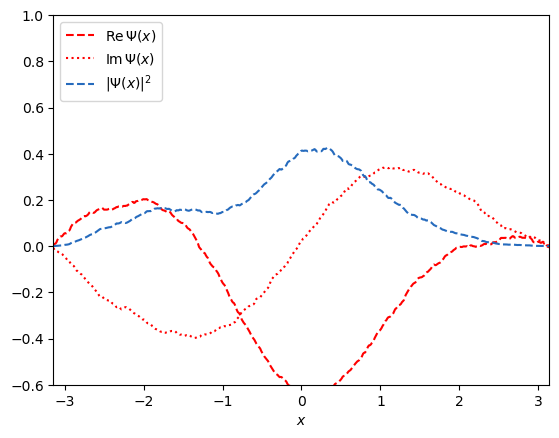

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# We use Hartree atomic units \hbar = m = 1

# Define the potential for the harmonic oscillator
def V(x):
    w = 1                       # to be changed later
    return 0.5 * w**2 * x**2 

# Define the domain
x_domain = [-np.pi, np.pi]  # spatial domain
t_domain = [0, 2*np.pi]     # temporal domain

N = 512                                   # Number of grid points
dx = (x_domain[1] - x_domain[0]) / (N-1)  # Define spatial step size
dt = (t_domain[1] - t_domain[0]) / (N-1)  # Define temporal step size

x = np.linspace(x_domain[0], x_domain[1], N)  # Define grid points

# Create Hamiltonian matrix and calculate its eigenvectors and eigenvalues
T = -0.5 * (np.diag(np.ones(N-1), k=-1) - 2*np.diag(np.ones(N), k=0) + np.diag(np.ones(N-1), k=-1)) / (dx**2)
H = (T + np.diag(V(x))) * dt

Lambda, Q = np.linalg.eigh(H)  # Eigenvalues and eigenvectors of H
Q_inv = Q.conj().T  # Inverse of eigenvector Q (i.e., Q^-1 = Q^+)

# Initial Gaussian wave packet
d = np.sqrt(2.0)
k = 1.0
Psi = 1.0 / (np.pi**0.25 * np.sqrt(d)) * np.exp(-x**2.0 / (2.0 * d**2) + 1j * k * x)

# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_xlim(x_domain[0], x_domain[1])
ax.set_ylim(-0.6, 1.0)
ax.set_xlabel(r'$x$')

# Plot elements
line_real, = ax.plot([], [], "--r", label=r'$\mathrm{Re}\, \Psi(x)$')
line_imag, = ax.plot([], [], ":r", label=r'$\mathrm{Im}\, \Psi(x)$')
line_prob, = ax.plot([], [], "--", color="#266bbd", label=r'$|\Psi(x)|^2$')
ax.legend(loc='upper left')

# Initialization function
def init():
    line_real.set_data([], [])
    line_imag.set_data([], [])
    line_prob.set_data([], [])
    return line_real, line_imag, line_prob

# Update function
def update(frame):
    global Psi
    Psi = np.dot(Q_inv, Psi)  # Expand into eigenfunctions/vectors
    Psi *= np.exp(-1j * Lambda)  # Propagate eigenfunctions/vectors
    Psi = np.dot(Q, Psi)  # Superpose eigenfunctions/vectors

    line_real.set_data(x, Psi.real)
    line_imag.set_data(x, Psi.imag)
    line_prob.set_data(x, Psi.real**2 + Psi.imag**2)

    return line_real, line_imag, line_prob

# Create animation
ani = animation.FuncAnimation(fig, update, frames=N, init_func=init, blit=True)

# Show the animation
# plt.show()
HTML(ani.to_jshtml())